## Abstract
This lab is dedicated to application of an advanced analysis of Big Data to the spread of COVID-19 in the world. We will study how to make image recognition of a chest X-ray to provide a diagnosis forecast.

## Introduction
X-rays are widely used in medical practice. They can be used to identify various diseases. However, a diagnosis depends on a doctor's experience, which can lead to improper treatment. Modern methods of artificial intelligence and pattern recognition make it possible to create expert systems that allow you to establish a diagnosis automatically.

This lab will show you how to upload images, transform them, and determine the basic features that underlie diseases classification.

Two different approaches to the classification of images (diseases) will be shown:

Different classical methods and their comparison
Convolutional Neural Networks.

## Objectives
* Create features of images.
* Build different classification models.
* Build CNN models.
* Build a diagnosis based on X-ray photos.

## Required libraries installation

In [1]:
pip install mahotas

     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 5.7/5.7 MB 44.8 MB/s eta 0:00:0000:0100:01
Note: you may need to restart the kernel to use updated packages.


## Required libraries import

Here we are going to use Mahotas for image processing and Keras library for creating our CNN model and its training. We will also use Matplotlib and Seaborn for visualizing our dataset to gain a better understanding of the images we are going to handle.
We will also use libraries os and glob to work with files and folders. NumPy will be applied for arrays of images. Scikit-Learn will be used for classical classification models. And we will take Pandas for present comparison of classifiers

In [2]:
import mahotas as mh
import seaborn as sns
from matplotlib import pyplot as plt 
from glob import glob
import os
import numpy as np
import pandas as pd

from sklearn.pipeline import Pipeline
from sklearn.preprocessing import StandardScaler 

#Classifiers
from sklearn.linear_model import LogisticRegression 
from sklearn.neighbors import KNeighborsClassifier
from sklearn.svm import SVC
from sklearn.gaussian_process import GaussianProcessClassifier
from sklearn.gaussian_process.kernels import RBF
from sklearn.tree import DecisionTreeClassifier
from sklearn.ensemble import RandomForestClassifier, AdaBoostClassifier
from sklearn.naive_bayes import GaussianNB
from sklearn.discriminant_analysis import QuadraticDiscriminantAnalysis
from sklearn.neural_network import MLPClassifier
from sklearn.metrics import plot_confusion_matrix

## Data loading
Images must be the same size in order to rank. In order to achieve this, here we will make a general change which will specify the size (height and width) to resize the image. Both are 224 in our case.

In [3]:
# new size for image 
IMM_SIZE = 224

For convenience, we create a function that downloads and displays all images from a specific directory.
To categorize images, all images must be placed in subdirectories. The names of these subdirectories are actually the names of classes.
In our case, the images are x-rays that should be placed in subfolders with the names of the diagnoses.
For example, the COVID subfolder is for containing X-ray images of people with this disease.
First of all, we must create a list of subfolders, which is a list of categories of possible diseases. In our case, it would be: normal pneumonia, COVID, viral.

Next, we need to create a list of all the images.
Next, let's download and pre-process all the images

In [4]:
def get_data(folder):
    class_names = [f for f in os.listdir(folder) if not f.startswith('.')] # ctreate a list of SubFolders
    data = []
    print(class_names)
    for t, f in enumerate(class_names):
        images = glob(folder + "/" + f + "/*") # create a list of files
        print("Downloading: ", f)
        fig = plt.figure(figsize = (50,50)) 
        for im_n, im in enumerate(images):
            plt.gray() # set grey colormap of images
            image = mh.imread(im)
            if len(image.shape) > 2:
                image = mh.resize_to(image, [IMM_SIZE, IMM_SIZE, image.shape[2]]) # resize of RGB and png images
            else:
                image = mh.resize_to(image, [IMM_SIZE, IMM_SIZE]) # resize of grey images    
            if len(image.shape) > 2:
                image = mh.colors.rgb2grey(image[:,:,:3], dtype = np.uint8)  # change of colormap of images alpha chanel delete
            plt.subplot(int(len(images)/5)+1,5,im_n+1) # create a table of images
            plt.imshow(image)
            data.append([image, f])
        plt.show()

    return np.array(data)   

['Normal', 'Viral Pneumonia', 'Covid']
Downloading:  Normal


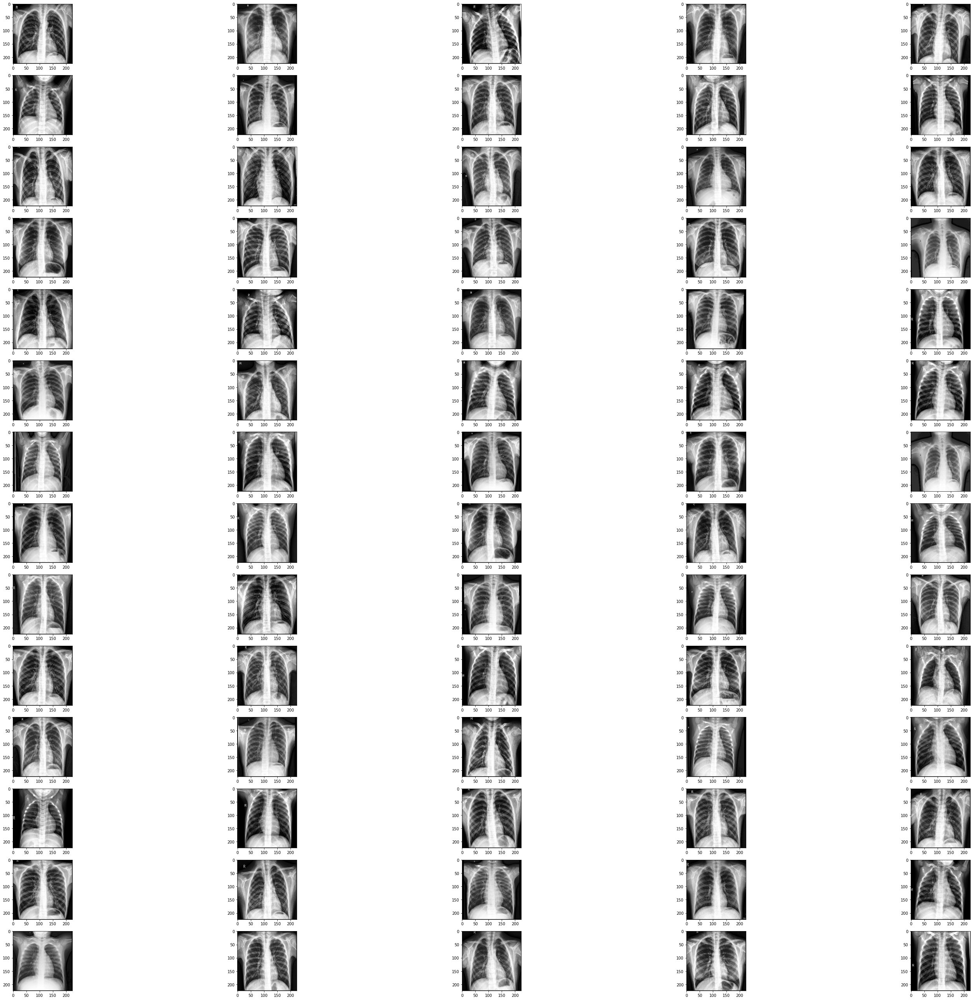

Downloading:  Viral Pneumonia


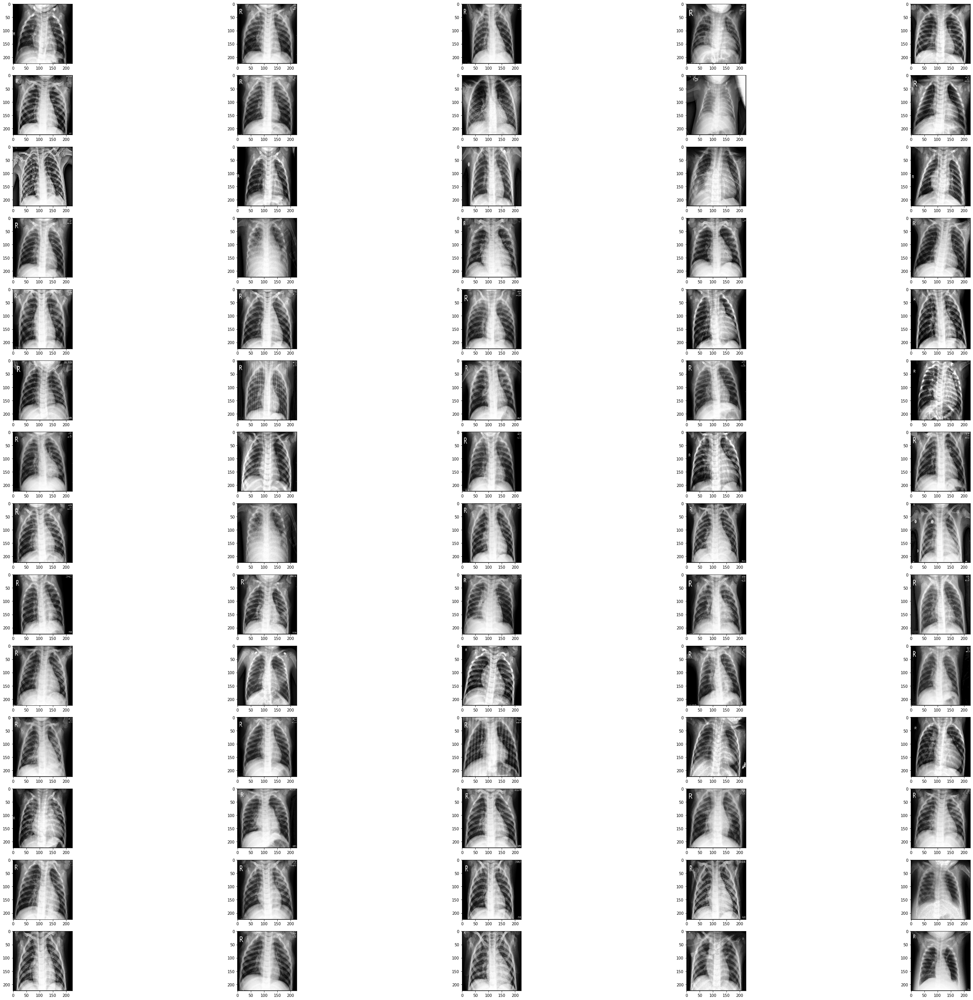

Downloading:  Covid


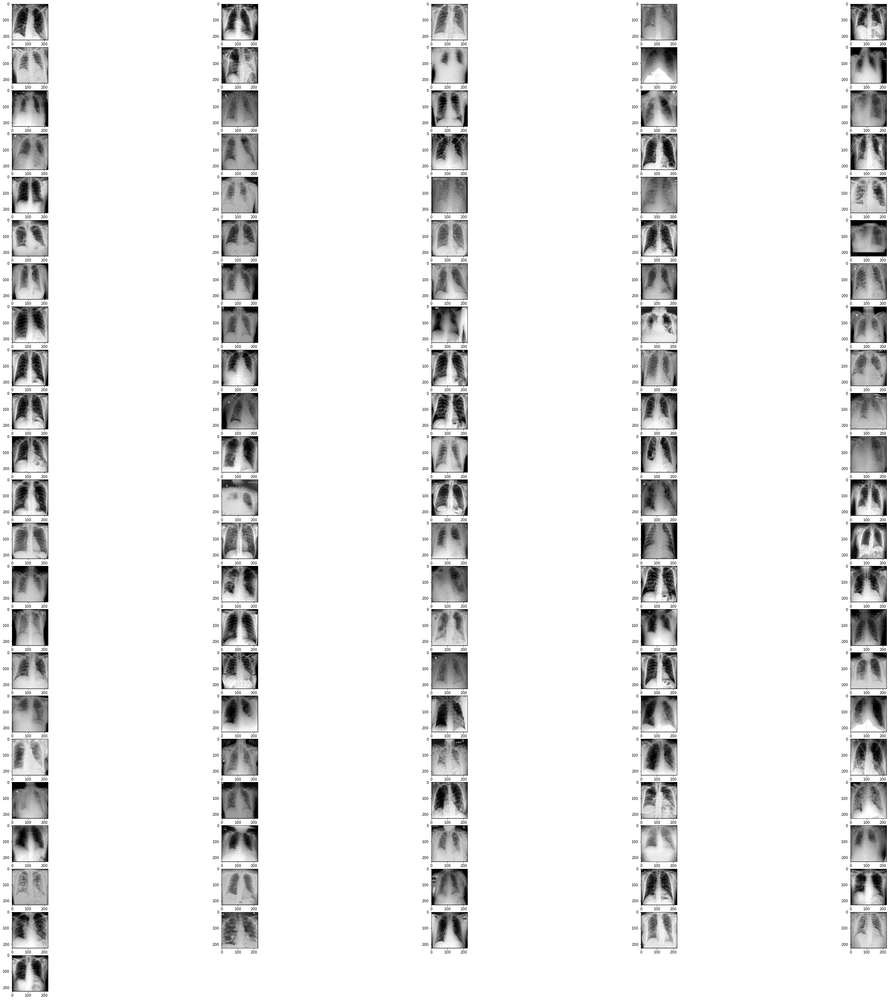

/opt/conda/lib/python3.7/site-packages/ipykernel_launcher.py:23: VisibleDeprecationWarning: Creating an ndarray from ragged nested sequences (which is a list-or-tuple of lists-or-tuples-or ndarrays with different lengths or shapes) is deprecated. If you meant to do this, you must specify 'dtype=object' when creating the ndarray.


['Normal', 'Viral Pneumonia', 'Covid']
Downloading:  Normal


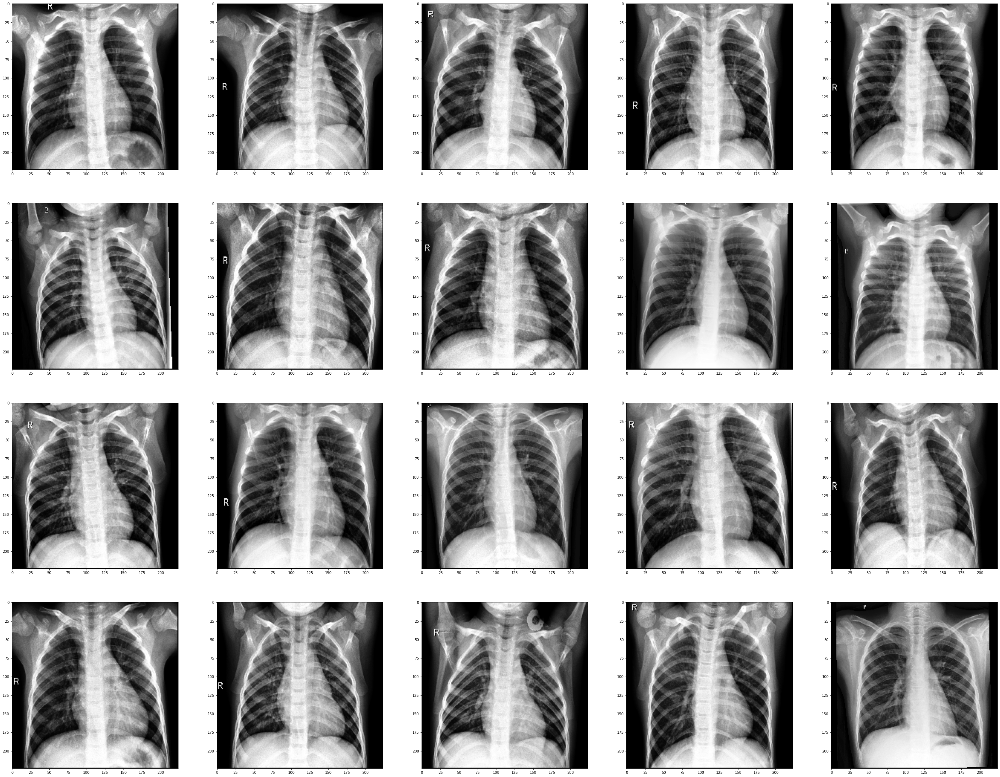

Downloading:  Viral Pneumonia


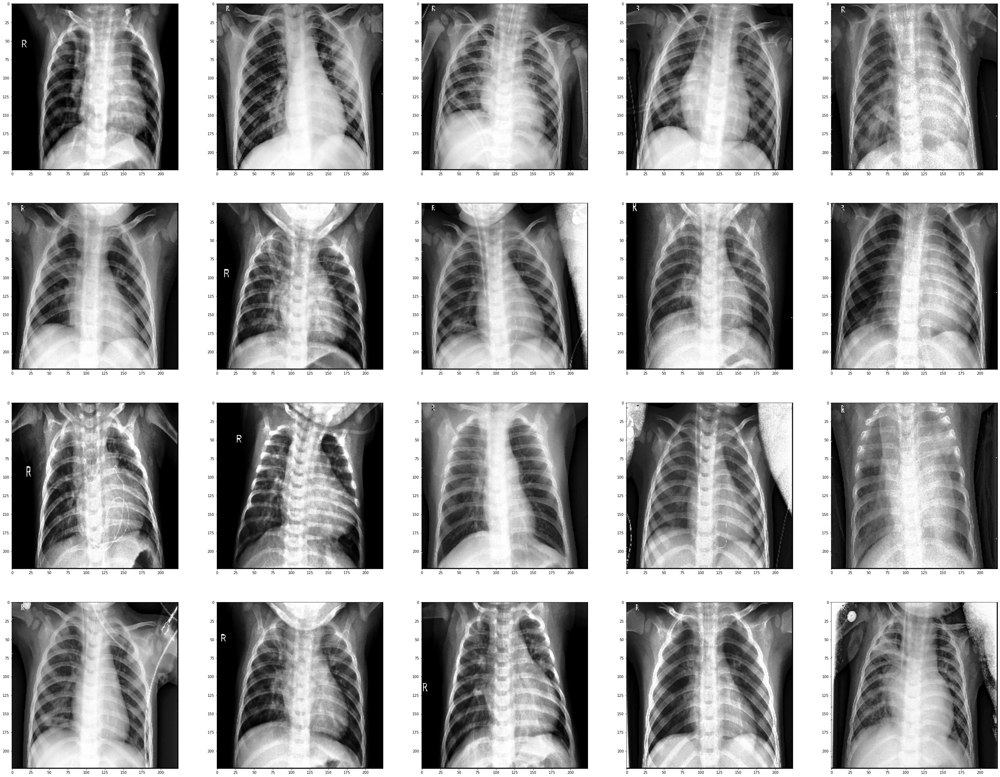

Downloading:  Covid


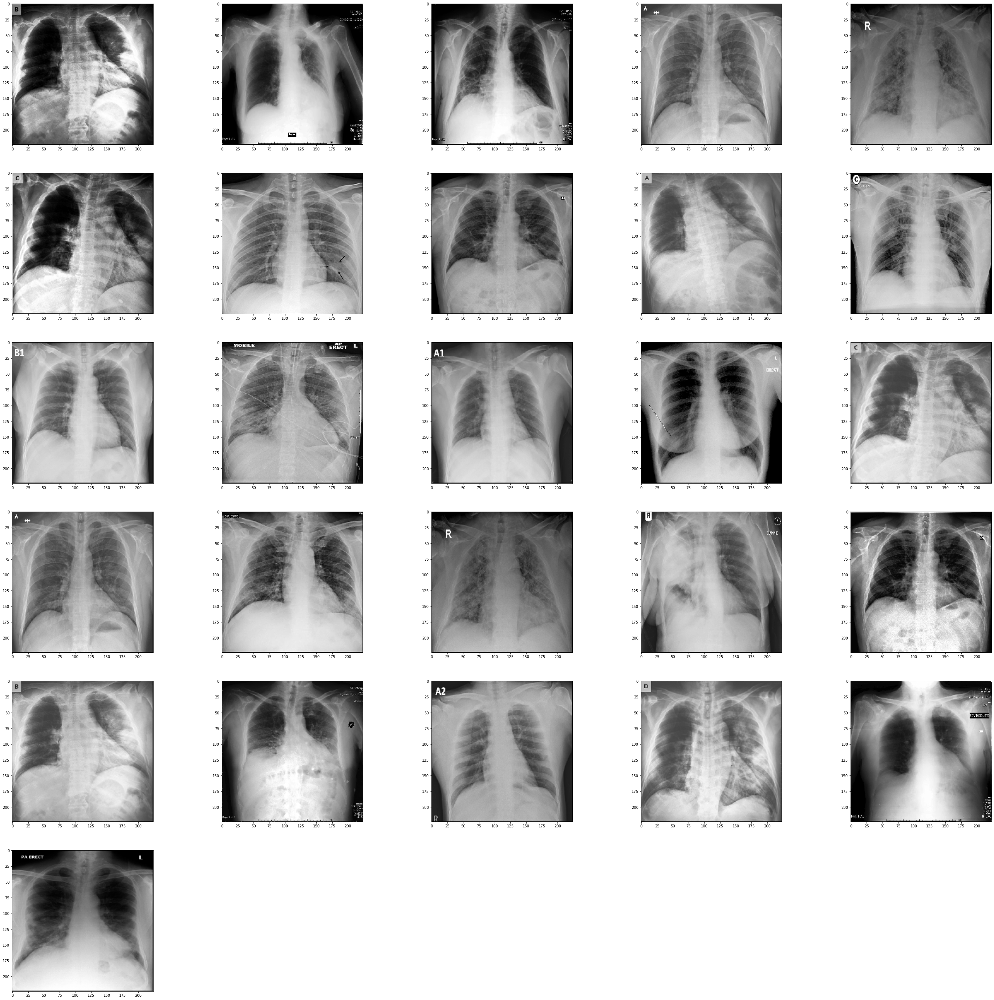

In [5]:
dir_train='../input/covid19-image-dataset/Covid19-dataset/train'
train=get_data(dir_train)
dir_test='../input/covid19-image-dataset/Covid19-dataset/test'
test=get_data(dir_test)

In [8]:
print("Train shape", train.shape) # Size of the training DataSet
print("Test shape", test.shape) # Size of the test DataSet
print("Image size", train[0][0].shape) # Size of image

Train shape (251, 2)
Test shape (66, 2)
Image size (224, 224)


As you can see, the training DataSet consists of 251 images and the test one consists of 66 images. All the images are in grey 2D (224x224) format.

## Data visualization
Let’s visualize our data and see what exactly we are working with. We use Seaborn to plot the number of images in all the classes. You can see what the output looks like.

/opt/conda/lib/python3.7/site-packages/seaborn/_decorators.py:43: FutureWarning: Pass the following variable as a keyword arg: x. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misinterpretation.
  FutureWarning


<AxesSubplot:ylabel='count'>

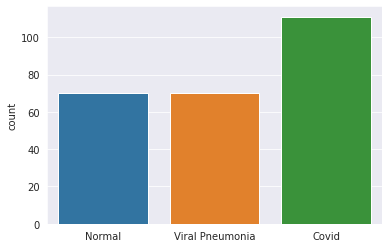

In [9]:
l = []
for i in train:
    l.append(i[1])
sns.set_style('darkgrid')
sns.countplot(l)

Let us also visualize the first image from the Viral Pneumonia and Covid classes in the training DataSet:

Text(0.5, 1.0, 'Viral Pneumonia')

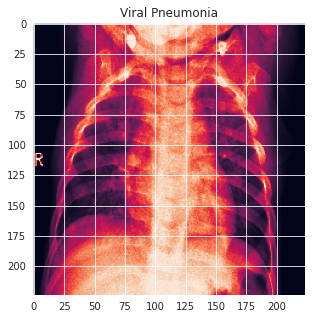

In [10]:
plt.figure(figsize = (5,5))
plt.imshow(train[np.where(train[:,1] == 'Viral Pneumonia')[0][0]][0])
plt.title('Viral Pneumonia')

Text(0.5, 1.0, 'Covid')

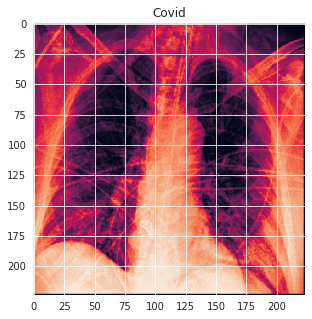

In [11]:
plt.figure(figsize = (5,5))
plt.imshow(train[np.where(train[:,1] == 'Covid')[0][0]][0])
plt.title('Covid')


## Image features creation
To classify objects, you need to transform the data set so that the input is a set of features and the output is an object class. An image is a matrix of pixels. Each pixel is a color. Therefore, it is impossible to submit a bare picture into a classical classifier's input. It is necessary to turn each picture into a set of certain features.

Mahotas makes it easy to calculate features of an image.
The corresponding functions are found in the [mahotas.features](https://mahotas.readthedocs.io/en/latest/?utm_medium=Exinfluencer&utm_source=Exinfluencer&utm_content=000026UJ&utm_term=10006555&utm_id=NA-SkillsNetwork-Channel-SkillsNetworkQuickLabsdatascienceinhealthcareadvancedmachinelearningclassification27247729-2022-01-01) submodule. The Haralick set of texture features is well known. Like many image processing algorithms, it is named for its inventor. The features are based on textures, that is, they distinguish between structured and unstructured images, as well as various repetitive structures. With the help of Mahotas, these features are calculated very easily:
haralick_features = mh.features.haralick (image)
haralick_features_mean = np.mean (haralick_features, axis = O)
haralick_features_all = np.ravel (haralick_features)
The mh.features.haralick function returns a 4 x 13 array wiсh should be transformad into 1D by [NumPy.ravel()](https://numpy.org/doc/stable/reference/generated/numpy.ravel.html?utm_medium=Exinfluencer&utm_source=Exinfluencer&utm_content=000026UJ&utm_term=10006555&utm_id=NA-SkillsNetwork-Channel-SkillsNetworkQuickLabsdatascienceinhealthcareadvancedmachinelearningclassification27247729-2022-01-01). The first dimension is the four possible directions in which the features are calculated (vertical, horizontal, and two diagonals). If we are not interested in any particular direction, then we can average the features in all directions (in the code above, this variable is called haralick_features_mean). Alternatively, you can use all the characteristics individually (variable haralick_features_all). The choice depends on the properties of a particular dataset. We decided that the vertical and horizontal features should be stored separately in our case, so we use haralick_features_all.

We should make a function for the DataSet features creation.

In [12]:
def create_features(data):
    features = []
    labels = []
    for image, label in data:
        features.append(mh.features.haralick(image).ravel())
        labels.append(label)
    features = np.array(features)
    labels = np.array(labels)
    return (features, labels) 

In [13]:
features_train, labels_train = create_features(train)
features_test, labels_test = create_features(test)

In [17]:
print("The features_train shape is: ",features_train.shape)
print("The features_test shape is: ",features_test.shape)
print("The labels_train shape is: ", labels_train.shape)
print("The label_test shape is: ",labels_test.shape)

The features_train shape is:  (251, 52)
The features_test shape is:  (66, 52)
The labels_train shape is:  (251,)
The label_test shape is:  (66,)


## Comparing different classical classification methods
If we want to compare some classificators, we should use a Pipeline. A pipeline helps to chain multiple estimators into a single one. This is useful as there is often a fixed number of steps in data processing, for example, feature selection, normalization and classification. A pipeline serves multiple purposes here:

You only have to call fit() once to evaluate a whole sequence of estimators.

You can grid search over parameters of all estimators in the pipeline at once.

Pipelines help to avoid leaking statistics from your test data into the trained model in cross-validation by ensuring that the same samples are used to train the transformers and predictors. All estimators in a pipeline, except the last one, should be transformers (i.e. should have a transform method). The last estimator may be of any type (transformer, classifier, etc.).

The sklearn.pipeline module implements utilities to build a composite estimator, as a chain of transforms and estimators.

In order to test how it works, we will use LogisticRegression.

In [26]:
clf = Pipeline([('preproc', StandardScaler()), ('classifier', LogisticRegression())])
clf.fit(features_train, labels_train)
scores_train = clf.score(features_train, labels_train)
scores_test = clf.score(features_test, labels_test)

/opt/conda/lib/python3.7/site-packages/sklearn/linear_model/_logistic.py:818: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  extra_warning_msg=_LOGISTIC_SOLVER_CONVERGENCE_MSG,


In [27]:
print('Training DataSet accuracy: {: .1%}'.format(scores_train), 'Test DataSet accuracy: {: .1%}'.format(scores_test))

Training DataSet accuracy:  89.6% Test DataSet accuracy:  84.8%


/opt/conda/lib/python3.7/site-packages/sklearn/utils/deprecation.py:87: FutureWarning: Function plot_confusion_matrix is deprecated; Function `plot_confusion_matrix` is deprecated in 1.0 and will be removed in 1.2. Use one of the class methods: ConfusionMatrixDisplay.from_predictions or ConfusionMatrixDisplay.from_estimator.
  warnings.warn(msg, category=FutureWarning)


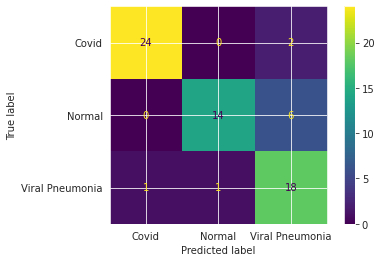

In [21]:
plot_confusion_matrix(clf, features_test, labels_test)  
plt.show() 

As you can see, the results are not bad.
Conflusion matrix shows us how many mistaken predictions we got.
It allows us to check other classifiers and compare the results.
We will test:
* Logistic Regression
* Nearest Neighbors
* Linear SVM
* RBF SVM
* Gaussian Process
* Decision Tree
* Random Forest
*  Multi-layer Perceptron classifier
* Ada Boost
* Naive Bayes
* Quadratic Discriminant Analysis

In [28]:
names = ["Logistic Regression", "Nearest Neighbors", "Linear SVM", "RBF SVM", "Gaussian Process",
         "Decision Tree", "Random Forest", "Neural Net", "AdaBoost",
         "Naive Bayes", "QDA"]

classifiers = [
    LogisticRegression(),
    KNeighborsClassifier(3),
    SVC(kernel="linear", C=0.025),
    SVC(gamma=2, C=1),
    GaussianProcessClassifier(1.0 * RBF(1.0)),
    DecisionTreeClassifier(max_depth=5),
    RandomForestClassifier(max_depth=5, n_estimators=10, max_features=1),
    MLPClassifier(alpha=1, max_iter=1000),
    AdaBoostClassifier(),
    GaussianNB(),
    QuadraticDiscriminantAnalysis()]
scores_train = []
scores_test = []
for name, clf in zip(names, classifiers):
    clf = Pipeline([('preproc', StandardScaler()), ('classifier', clf)])
    clf.fit(features_train, labels_train)
    score_train = clf.score(features_train, labels_train)
    score_test = clf.score(features_test, labels_test)
    scores_train.append(score_train)
    scores_test.append(score_test)

/opt/conda/lib/python3.7/site-packages/sklearn/linear_model/_logistic.py:818: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  extra_warning_msg=_LOGISTIC_SOLVER_CONVERGENCE_MSG,
/opt/conda/lib/python3.7/site-packages/sklearn/discriminant_analysis.py:878: UserWarning: Variables are collinear
  warnings.warn("Variables are collinear")


Let's print the results as a table.

In [29]:
res = pd.DataFrame(index = names)
res['scores_train'] = scores_train
res['scores_test'] = scores_test
res.columns = ['Test','Train']
res.index.name = "Classifier accuracy"
pd.options.display.float_format = '{:,.2f}'.format
print(res)

                     Test  Train
Classifier accuracy             
Logistic Regression  0.90   0.85
Nearest Neighbors    0.87   0.70
Linear SVM           0.79   0.71
RBF SVM              1.00   0.48
Gaussian Process     0.79   0.67
Decision Tree        0.90   0.62
Random Forest        0.88   0.61
Neural Net           0.91   0.80
AdaBoost             0.86   0.58
Naive Bayes          0.67   0.59
QDA                  1.00   0.58


You can see that the calculations are very fast and that Logistic Regression and Neural Network show the best result for the test DataSet.

Let's compare the results on a plot.

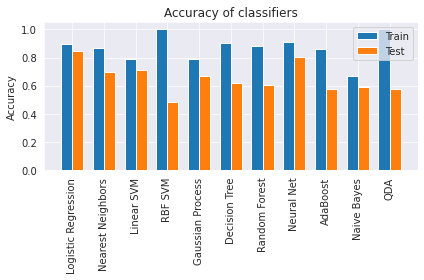

In [30]:
x = np.arange(len(names))  # the label locations
width = 0.35  # the width of the bars

fig, ax = plt.subplots()
rects1 = ax.bar(x - width/2, scores_train, width, label='Train')
rects2 = ax.bar(x + width/2, scores_test, width, label='Test')

# Add some text for labels, title and custom x-axis tick labels, etc.
ax.set_ylabel('Accuracy')
ax.set_title('Accuracy of classifiers')
ax.set_xticks(x)
plt.xticks(rotation = 90)
ax.set_xticklabels(names)
ax.legend()

fig.tight_layout()

plt.show()

# Building and fitting Convolutional Neural Network


## Required libraries import
We will use Keras library for creating and training our model.

In [32]:
import keras
from keras.models import Sequential
from keras.layers import Dense, Conv2D , MaxPool2D , Flatten , Dropout 
from keras.preprocessing.image import ImageDataGenerator
from tensorflow.keras.optimizers import Adam 
import tensorflow as tf
from sklearn.metrics import classification_report,confusion_matrix

# Data preprocessing and data augmentation¶
What is different about Convolutional Neural Networks is that we can submit images directly to the input. However, these images also require pre-processing.

In particular, it is necessary to normalize the pixels color, i.e. to normalize them from the range [0, 255) to [0, 1).

You also need to change the dimension of the input images because of Keras framework.

Image classes should be of numeric type instead of string.

The code below makes the necessary transformations.

In [37]:
x_train = []
y_train = []
x_val = []
y_val = []

for feature, label in train:
    x_train.append(feature)
    y_train.append(label)

for feature, label in test:
    x_val.append(feature)
    y_val.append(label)

# Normalize the data
x_train = np.array(x_train) / 255
x_val = np.array(x_val) / 255

# Reshaping input images
x_train = x_train.reshape(-1, IMM_SIZE, IMM_SIZE, 1)
x_val = x_val.reshape(-1, IMM_SIZE, IMM_SIZE, 1)

# Creating a dictionary of clases
lab = {}
for i, l in enumerate(set(y_train)):
    lab[l] = i


y_train = np.array([lab[l] for l in y_train])
y_val = np.array([lab[l] for l in y_val])

In [38]:
print("Shape of the input DataSet:", x_train.shape)
print("Shape of the output DataSet:", y_train.shape)
print("Dictionary of classes:", lab)

Shape of the input DataSet: (251, 224, 224, 1)
Shape of the output DataSet: (251,)
Dictionary of classes: {'Viral Pneumonia': 0, 'Normal': 1, 'Covid': 2}


# Data augmentation on the training data
We should perform data augmentation to fit our model better

In [39]:
datagen = ImageDataGenerator(
        featurewise_center=False,  # set input mean to 0 over the dataset
        samplewise_center=False,  # set each sample mean to 0
        featurewise_std_normalization=False,  # divide inputs by std of the dataset
        samplewise_std_normalization=False,  # divide each input by its std
        zca_whitening=False,  # apply ZCA whitening
        rotation_range = 30,  # randomly rotate images in the range (degrees, 0 to 180)
        zoom_range = 0.2, # Randomly zoom image 
        width_shift_range=0.1,  # randomly shift images horizontally (fraction of total width)
        height_shift_range=0.1,  # randomly shift images vertically (fraction of total height)
        horizontal_flip = True,  # randomly flip images
        vertical_flip=False)  # randomly flip images


datagen.fit(x_train)

## Model defining
Let’s define a simple CNN model with 3 Convolutional layers followed by max-pooling layers. A dropout layer is added after the 3rd maxpool operation to avoid overfitting.

In [40]:
model = Sequential()
model.add(Conv2D(32,1,padding="same", activation="relu", input_shape=(IMM_SIZE,IMM_SIZE,1)))
model.add(MaxPool2D())

model.add(Conv2D(32, 1, padding="same", activation="relu"))
model.add(MaxPool2D())

model.add(Conv2D(64, 1, padding="same", activation="relu"))
model.add(MaxPool2D())
model.add(Dropout(0.4))

model.add(Flatten())
model.add(Dense(128,activation="relu"))
model.add(Dense(3, activation="softmax"))

2022-07-08 21:19:34.432010: I tensorflow/stream_executor/cuda/cuda_gpu_executor.cc:937] successful NUMA node read from SysFS had negative value (-1), but there must be at least one NUMA node, so returning NUMA node zero
2022-07-08 21:19:34.544127: I tensorflow/stream_executor/cuda/cuda_gpu_executor.cc:937] successful NUMA node read from SysFS had negative value (-1), but there must be at least one NUMA node, so returning NUMA node zero
2022-07-08 21:19:34.544967: I tensorflow/stream_executor/cuda/cuda_gpu_executor.cc:937] successful NUMA node read from SysFS had negative value (-1), but there must be at least one NUMA node, so returning NUMA node zero
2022-07-08 21:19:34.546328: I tensorflow/core/platform/cpu_feature_guard.cc:142] This TensorFlow binary is optimized with oneAPI Deep Neural Network Library (oneDNN) to use the following CPU instructions in performance-critical operations:  AVX2 AVX512F FMA
To enable them in other operations, rebuild TensorFlow with the appropriate compil

In [41]:
model.summary()

Model: "sequential"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
conv2d (Conv2D)              (None, 224, 224, 32)      64        
_________________________________________________________________
max_pooling2d (MaxPooling2D) (None, 112, 112, 32)      0         
_________________________________________________________________
conv2d_1 (Conv2D)            (None, 112, 112, 32)      1056      
_________________________________________________________________
max_pooling2d_1 (MaxPooling2 (None, 56, 56, 32)        0         
_________________________________________________________________
conv2d_2 (Conv2D)            (None, 56, 56, 64)        2112      
_________________________________________________________________
max_pooling2d_2 (MaxPooling2 (None, 28, 28, 64)        0         
_________________________________________________________________
dropout (Dropout)            (None, 28, 28, 64)        0

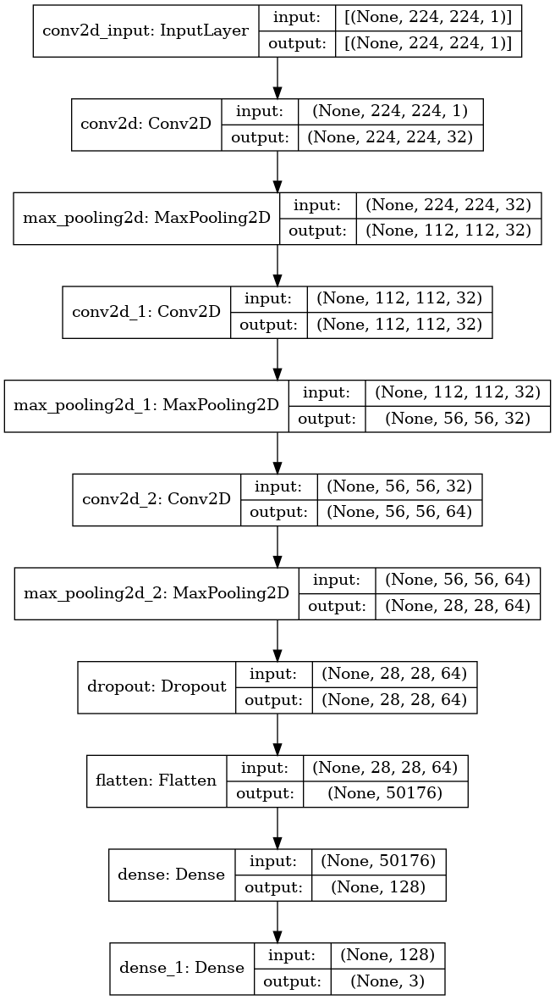

In [42]:
from tensorflow.keras.utils import to_categorical, plot_model
plot_model(model, to_file='cnn-for covied-19.png', show_shapes=True)

Let’s compile the model now using Adam as our optimizer and SparseCategoricalCrossentropy as the loss function. We are using a lower learning rate of 0.000001 for a smoother curve.

In [43]:
opt = Adam(lr=0.000001)
model.compile(optimizer = opt , loss = tf.keras.losses.SparseCategoricalCrossentropy
              (from_logits=True)
              , metrics = ['accuracy'])

/opt/conda/lib/python3.7/site-packages/keras/optimizer_v2/optimizer_v2.py:356: UserWarning: The `lr` argument is deprecated, use `learning_rate` instead.
  "The `lr` argument is deprecated, use `learning_rate` instead.")


Now, let’s train our model for 2000 epochs. Admittedly, the fitting process is very slow. Therefore, we saved the fitted model to a file. To save time, we will upload the fitted model. If you would like, you can change the parameter fitting to True in order to refit the model.

In [55]:
fitting = False
fitting_save = False
epochs = 1000
import pickle


history = model.fit(x_train,y_train,epochs = epochs , validation_data = (x_val, y_val), shuffle = True)
   

Epoch 1/1000
8/8 [==============================] - 0s 33ms/step - loss: 0.3097 - accuracy: 0.9203 - val_loss: 0.5282 - val_accuracy: 0.8333
Epoch 2/1000
8/8 [==============================] - 0s 33ms/step - loss: 0.3089 - accuracy: 0.9124 - val_loss: 0.5279 - val_accuracy: 0.8333
Epoch 3/1000
8/8 [==============================] - 0s 27ms/step - loss: 0.3057 - accuracy: 0.9203 - val_loss: 0.5280 - val_accuracy: 0.8333
Epoch 4/1000
8/8 [==============================] - 0s 27ms/step - loss: 0.3114 - accuracy: 0.9243 - val_loss: 0.5275 - val_accuracy: 0.8333
Epoch 5/1000
8/8 [==============================] - 0s 27ms/step - loss: 0.3076 - accuracy: 0.9163 - val_loss: 0.5267 - val_accuracy: 0.8333
Epoch 6/1000
8/8 [==============================] - 0s 27ms/step - loss: 0.3051 - accuracy: 0.9283 - val_loss: 0.5263 - val_accuracy: 0.8333
Epoch 7/1000
8/8 [==============================] - 0s 27ms/step - loss: 0.3103 - accuracy: 0.9203 - val_loss: 0.5259 - val_accuracy: 0.8333
Epoch 8/1000


## Results evaluation
We will plot our training and validation accuracy along with the training and validation loss.

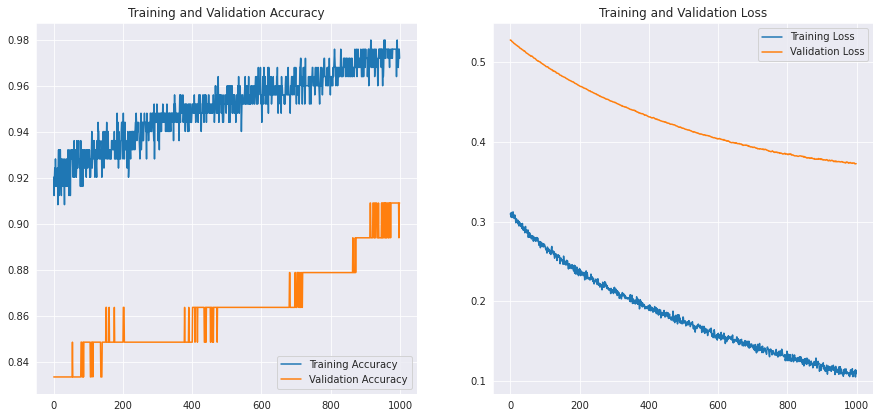

In [57]:
acc = history.history['accuracy']
val_acc = history.history['val_accuracy']

loss = history.history['loss']
val_loss = history.history['val_loss']
epochs_range = range(epochs)

plt.figure(figsize=(15, 15))
plt.subplot(2, 2, 1)
plt.plot(epochs_range, acc, label='Training Accuracy')
plt.plot(epochs_range, val_acc, label='Validation Accuracy')
plt.legend(loc='lower right')
plt.title('Training and Validation Accuracy')

plt.subplot(2, 2, 2)
plt.plot(epochs_range, loss, label='Training Loss')
plt.plot(epochs_range, val_loss, label='Validation Loss')
plt.legend(loc='upper right')
plt.title('Training and Validation Loss')
plt.show()

Also we can create a confusion matrix. Unfortunately, Keras framework does not have plot_confusion_matrix() function. Therefore, we have to create it using Pandas and Seaborn.heatmap()

In [63]:
predict_x=model.predict(x_val) 
classes_x=np.argmax(predict_x,axis=1)
print(classification_report(y_val, classes_x, target_names = lab.keys()))



                 precision    recall  f1-score   support

Viral Pneumonia       1.00      0.75      0.86        20
         Normal       0.91      1.00      0.95        20
          Covid       0.86      0.96      0.91        26

       accuracy                           0.91        66
      macro avg       0.92      0.90      0.91        66
   weighted avg       0.92      0.91      0.91        66



In [68]:
# Confusion matrix
cm = pd.DataFrame(confusion_matrix(y_val, classes_x))
cm.index = ["Predicted " + s for s in lab.keys()]
cm.columns = ["True  " + s for s in lab.keys()]
print(cm)



                           True  Viral Pneumonia  True  Normal  True  Covid
Predicted Viral Pneumonia                     15             1            4
Predicted Normal                               0            20            0
Predicted Covid                                0             1           25


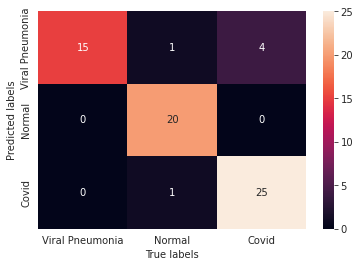

In [69]:
sns.heatmap(confusion_matrix(y_val, classes_x), annot=True, 
            xticklabels = list(lab.keys()), yticklabels = list(lab.keys()))
plt.xlabel("True labels")
plt.ylabel("Predicted labels")
plt.show()